***this n-gram includes whitespaces***

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns

Note: you may need to restart the kernel to use updated packages.


In [14]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils
import features.tf_idf.n_gram as thesisTfIdfNgramFeatures

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)
imp.reload(thesisTfIdfNgramFeatures)

<module 'features.tf_idf.n_gram' from '../src/features/tf_idf/n_gram.py'>

In [15]:
########
# In order to test new feature 
# you need to change only this functions
########
get_features = thesisTfIdfNgramFeatures.create_5_gram
get_zwickau_features = thesisTfIdfNgramFeatures.create_zwickau_5_gram
get_london_features = thesisTfIdfNgramFeatures.create_london_5_gram
get_breslau_features = thesisTfIdfNgramFeatures.create_breslau_5_gram

In [16]:
zwickau_corpus = thesisDataReader.get_zwickau_corpus()
london_corpus = thesisDataReader.get_london_corpus()
breslau_corpus = thesisDataReader.get_breslau_corpus()

In [23]:
zwickau_df = get_zwickau_features()
zwickau_similarities = cosine_similarity(zwickau_df, zwickau_df)

london_df = get_london_features()
london_similarities = cosine_similarity(london_df, london_df)

breslau_df = get_breslau_features()
breslau_similarities = cosine_similarity(breslau_df, breslau_df)

In [24]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [25]:
show_similarities_data(zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [6] value: 0.06512994209722124
index: [46] value: 0.07602769494544037
index: [49] value: 0.08065596755422001
index: [19] value: 0.08325286959453362
index: [321] value: 0.14871609129644245
index: [0] value: 1.0000000000000002
average: 0.011423098648614093
0 similarities: 138

___ max similariry for paragraph: 1 ___
index: [289] value: 0.07567784856543167
index: [196] value: 0.08273546127277405
index: [283] value: 0.09057824840944474
index: [5] value: 0.09673626564092368
index: [6] value: 0.10334748508733432
index: [1] value: 0.9999999999999979
average: 0.03425757656989192
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [289] value: 0.06485176003806803
index: [214] value: 0.06711594392884278
index: [5] value: 0.07042502785818452
index: [211] value: 0.09001414788975336
index: [212] value: 0.0977348523738441
index: [2] value: 1.0000000000000004
average: 0.026879464978133222
0 similarities: 4

___ max similariry for paragraph:

index: [204] value: 0.12834663718061942
index: [236] value: 0.13031787311192045
index: [203] value: 1.0000000000000004
average: 0.029695481247810945
0 similarities: 5

___ max similariry for paragraph: 204 ___
index: [155] value: 0.10228271118316543
index: [174] value: 0.11547262243982717
index: [182] value: 0.11937793722693309
index: [203] value: 0.12834663718061942
index: [252] value: 0.13266238496877503
index: [204] value: 1.0000000000000004
average: 0.02938968439543434
0 similarities: 2

___ max similariry for paragraph: 205 ___
index: [226] value: 0.07392456240751828
index: [240] value: 0.07756449591404595
index: [52] value: 0.07889033467599087
index: [202] value: 0.09919709471048724
index: [154] value: 0.1011416930043729
index: [205] value: 0.9999999999999997
average: 0.023674757001958625
0 similarities: 6

___ max similariry for paragraph: 206 ___
index: [258] value: 0.08166474497816703
index: [162] value: 0.08166836098249342
index: [236] value: 0.09088631859651336
index: [207] 

In [26]:
show_similarities_data(london_similarities)

___ max similariry for paragraph: 0 ___
index: [317] value: 0.0837744420646309
index: [272] value: 0.08852897125608553
index: [266] value: 0.0909809354077186
index: [21] value: 0.09132867306771318
index: [19] value: 0.1020277173458708
index: [0] value: 0.9999999999999997
average: 0.0127631830133826
0 similarities: 163

___ max similariry for paragraph: 1 ___
index: [225] value: 0.07648619833473008
index: [187] value: 0.07802719650201369
index: [205] value: 0.08096904158677112
index: [5] value: 0.08364699206033344
index: [275] value: 0.08462398499210849
index: [1] value: 0.9999999999999988
average: 0.03589976042489873
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [311] value: 0.06671739245657078
index: [281] value: 0.06958751951963843
index: [5] value: 0.0729811447078677
index: [218] value: 0.07678173809526015
index: [220] value: 0.07905947849225335
index: [2] value: 1.0000000000000004
average: 0.02906495516348988
0 similarities: 2

___ max similariry for paragrap

index: [308] value: 0.07721253089454709
index: [59] value: 0.08762146728978486
index: [303] value: 0.09561844227443854
index: [241] value: 0.1112592944747827
index: [249] value: 1.0
average: 0.03202625380265477
0 similarities: 2

___ max similariry for paragraph: 250 ___
index: [97] value: 0.1191694704663067
index: [260] value: 0.12243261125237685
index: [252] value: 0.15641016684147638
index: [251] value: 0.24719398350332644
index: [247] value: 0.33880665614745625
index: [250] value: 0.9999999999999999
average: 0.036122472851304356
0 similarities: 3

___ max similariry for paragraph: 251 ___
index: [56] value: 0.08906443870665691
index: [252] value: 0.10225146430209103
index: [260] value: 0.11374441718619806
index: [247] value: 0.17318515112022118
index: [250] value: 0.24719398350332644
index: [251] value: 1.0000000000000002
average: 0.029209710873601743
0 similarities: 4

___ max similariry for paragraph: 252 ___
index: [163] value: 0.09982555024211429
index: [251] value: 0.102251464

In [27]:
show_similarities_data(breslau_similarities)

___ max similariry for paragraph: 0 ___
index: [3] value: 0.07757138307470596
index: [49] value: 0.08423790176961429
index: [60] value: 0.08648292768279733
index: [1] value: 0.10820260400155428
index: [2] value: 0.15408960335155142
index: [0] value: 1.0000000000000007
average: 0.05296157079078736
0 similarities: None

___ max similariry for paragraph: 1 ___
index: [55] value: 0.09998807925410282
index: [32] value: 0.10207923014016097
index: [0] value: 0.10820260400155428
index: [2] value: 0.14627995595289975
index: [59] value: 0.1504967201138449
index: [1] value: 1.0000000000000042
average: 0.07655214248413343
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [62] value: 0.11786712917347911
index: [59] value: 0.11992811079417762
index: [61] value: 0.1209174504263301
index: [1] value: 0.14627995595289975
index: [0] value: 0.15408960335155142
index: [2] value: 1.0000000000000022
average: 0.08823872292021101
0 similarities: None

___ max similariry for paragraph: 3 ___


In [28]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [30]:
zwickau_max_similarity_per_p = get_max_similarity_per_p(zwickau_similarities)
london_max_similarity_per_p = get_max_similarity_per_p(london_similarities)
breslau_max_similarity_per_p = get_max_similarity_per_p(breslau_similarities)

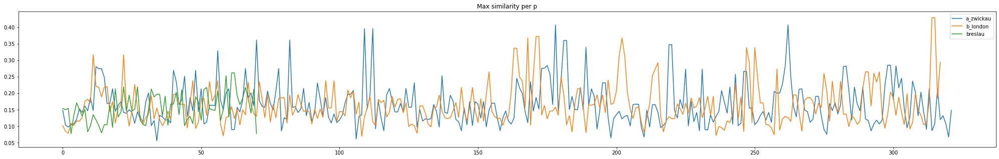

In [47]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(london_max_similarity_per_p, label="b_london")
ax.plot(breslau_max_similarity_per_p, label="breslau")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [32]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [33]:
zwickau_london_similarities = cross_version_similarity(zwickau_corpus, london_corpus)
zwickau_breslau_similarities = cross_version_similarity(zwickau_corpus, breslau_corpus)

london_zwickau_similarities = cross_version_similarity(london_corpus, zwickau_corpus)
london_breslau_similarities = cross_version_similarity(london_corpus, breslau_corpus)

breslau_zwickau_similarities = cross_version_similarity(breslau_corpus, zwickau_corpus)
breslau_london_similarities = cross_version_similarity(breslau_corpus, london_corpus)

In [34]:
# show_similarities_data(zwickau_london_similarities)

In [35]:
# show_similarities_data(london_zwickau_similarities)

In [36]:
zwickau_london_max_similarity_per_p = get_max_similarity_per_p(zwickau_london_similarities)
zwickau_breslau_max_similarity_per_p = get_max_similarity_per_p(zwickau_breslau_similarities)

london_zwickau_max_similarity_per_p = get_max_similarity_per_p(london_zwickau_similarities)
london_breslau_max_similarity_per_p = get_max_similarity_per_p(london_breslau_similarities)

breslau_zwickau_max_similarity_per_p = get_max_similarity_per_p(breslau_zwickau_similarities)
breslau_london_max_similarity_per_p = get_max_similarity_per_p(breslau_london_similarities)

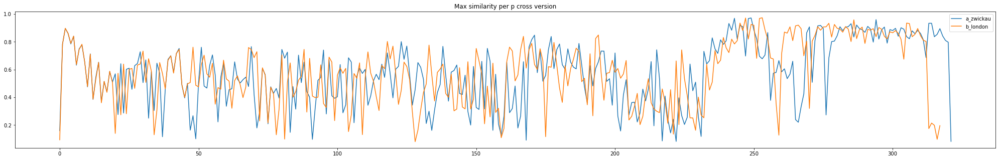

In [48]:
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(zwickau_london_max_similarity_per_p, label="a_zwickau")
ax.plot(london_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

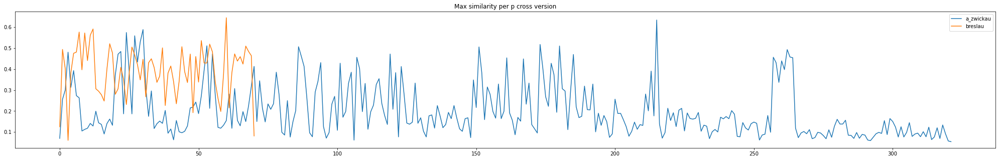

In [49]:
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(zwickau_breslau_max_similarity_per_p, label="a_zwickau")
ax.plot(breslau_zwickau_max_similarity_per_p, label="breslau")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

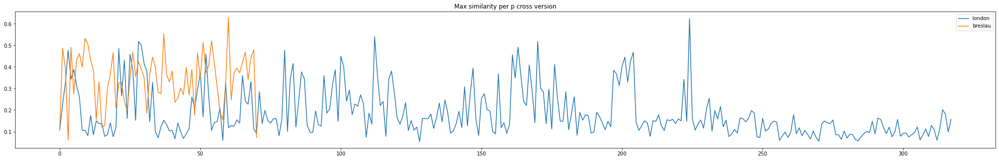

In [50]:
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(london_breslau_max_similarity_per_p, label="london")
ax.plot(breslau_london_max_similarity_per_p, label="breslau")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

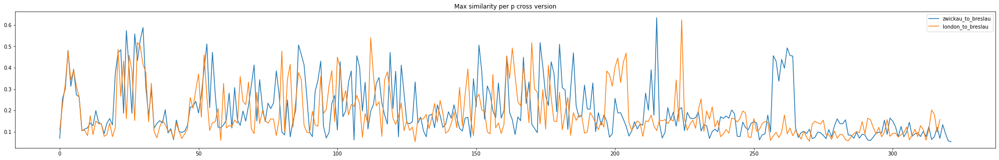

In [51]:
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(zwickau_breslau_max_similarity_per_p, label="zwickau_to_breslau")
ax.plot(london_breslau_max_similarity_per_p, label="london_to_breslau")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

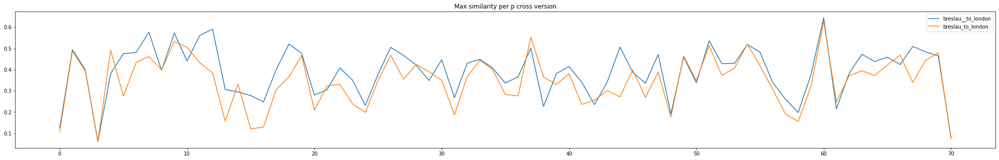

In [53]:
fig, ax = plt.subplots(figsize=(35, 5))
ax.plot(breslau_zwickau_max_similarity_per_p, label="breslau__to_london")
ax.plot(breslau_london_max_similarity_per_p, label="breslau_to_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [54]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    total = 0
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 2)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        total += len(max_indices_without_self)
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    print(total)
    return G

In [55]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [21]:
len(a_zwickau_similarities[0])

322

In [22]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

322
318


In [23]:
a_zwickau_G
nx.readwrite.graphml.write_graphml(a_zwickau_G, "zwickau_inner.graphml")

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

69
62


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

# sum(map(lambda node: node[1], a_zwickau_sorted_degree))
sum(list(map(lambda node: node[1], a_zwickau_sorted_degree))) / 2

[(283, 9), (87, 8), (70, 5), (6, 4), (15, 4), (13, 4), (105, 4), (213, 4), (43, 4), (48, 4), (111, 4), (223, 4), (184, 4), (169, 4), (262, 4), (182, 4), (279, 4), (196, 4), (290, 4), (299, 4), (5, 3), (18, 3), (24, 3), (104, 3), (71, 3), (221, 3), (84, 3), (301, 3), (147, 3), (175, 3), (177, 3), (156, 3), (165, 3), (176, 3), (220, 3), (273, 3), (280, 3), (289, 3), (321, 2), (8, 2), (21, 2), (14, 2), (25, 2), (29, 2), (239, 2), (49, 2), (35, 2), (50, 2), (54, 2), (195, 2), (281, 2), (60, 2), (94, 2), (55, 2), (69, 2), (56, 2), (58, 2), (73, 2), (66, 2), (77, 2), (247, 2), (140, 2), (274, 2), (89, 2), (109, 2), (91, 2), (240, 2), (92, 2), (95, 2), (185, 2), (103, 2), (206, 2), (114, 2), (112, 2), (124, 2), (126, 2), (121, 2), (123, 2), (132, 2), (253, 2), (134, 2), (225, 2), (255, 2), (145, 2), (151, 2), (152, 2), (154, 2), (219, 2), (201, 2), (162, 2), (231, 2), (164, 2), (266, 2), (173, 2), (174, 2), (263, 2), (181, 2), (194, 2), (197, 2), (252, 2), (208, 2), (214, 2), (215, 2), (226, 

253.0

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(275, 7), (164, 7), (205, 6), (153, 6), (25, 5), (192, 5), (314, 5), (261, 5), (163, 5), (144, 4), (98, 4), (291, 4), (97, 4), (51, 4), (71, 4), (82, 4), (235, 4), (162, 4), (222, 4), (282, 4), (313, 4), (272, 3), (79, 3), (46, 3), (26, 3), (42, 3), (56, 3), (92, 3), (85, 3), (80, 3), (103, 3), (174, 3), (121, 3), (151, 3), (203, 3), (172, 3), (171, 3), (185, 3), (178, 3), (183, 3), (214, 3), (237, 3), (289, 3), (250, 3), (281, 3), (19, 2), (220, 2), (5, 2), (271, 2), (27, 2), (20, 2), (8, 2), (13, 2), (11, 2), (15, 2), (209, 2), (24, 2), (37, 2), (243, 2), (34, 2), (186, 2), (253, 2), (49, 2), (68, 2), (231, 2), (59, 2), (61, 2), (62, 2), (177, 2), (63, 2), (65, 2), (69, 2), (70, 2), (74, 2), (230, 2), (83, 2), (88, 2), (194, 2), (274, 2), (93, 2), (96, 2), (100, 2), (104, 2), (105, 2), (106, 2), (293, 2), (118, 2), (120, 2), (124, 2), (167, 2), (303, 2), (130, 2), (134, 2), (155, 2), (154, 2), (160, 2), (166, 2), (168, 2), (202, 2), (204, 2), (199, 2), (200, 2), (201, 2), (266, 2), 

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

0
[]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

0
[]


In [29]:
nx.readwrite.graphml.write_graphml(a_zwickau_G, "a_zwickau_G.graphml")

<IPython.core.display.Javascript object>


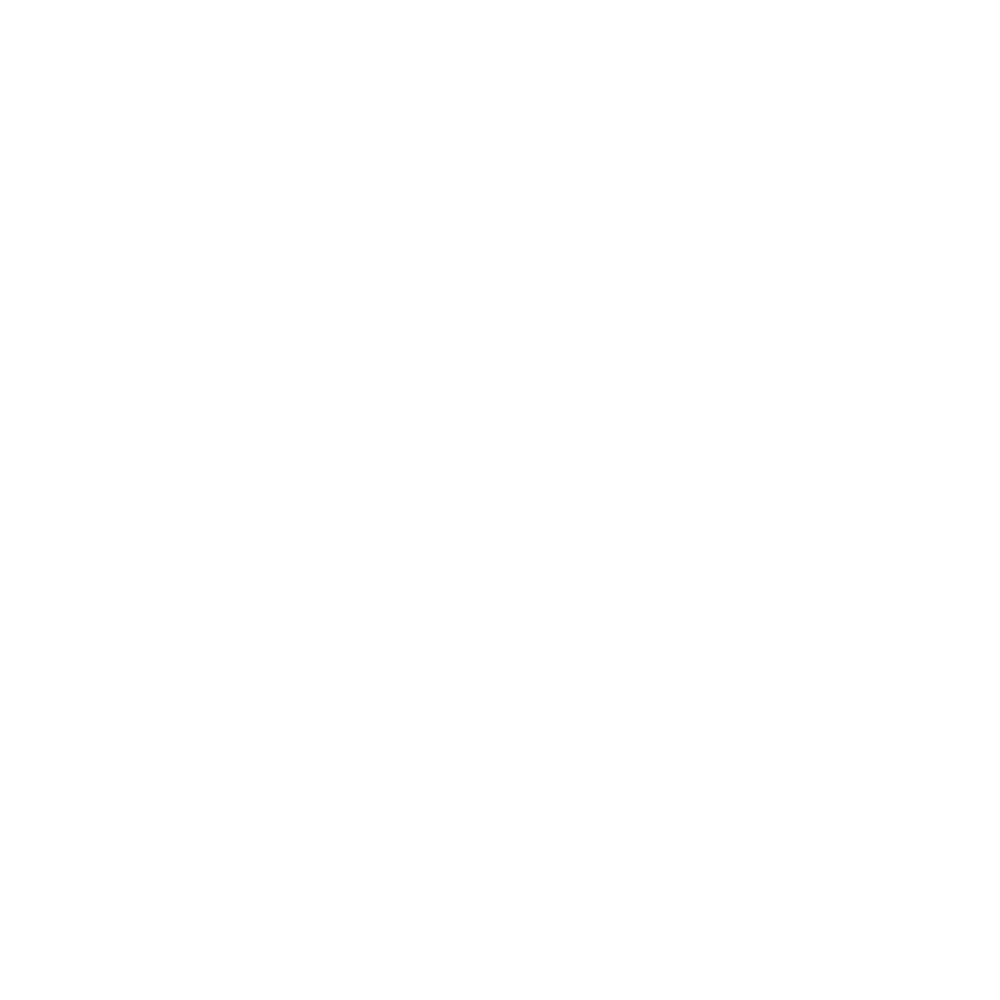

In [30]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


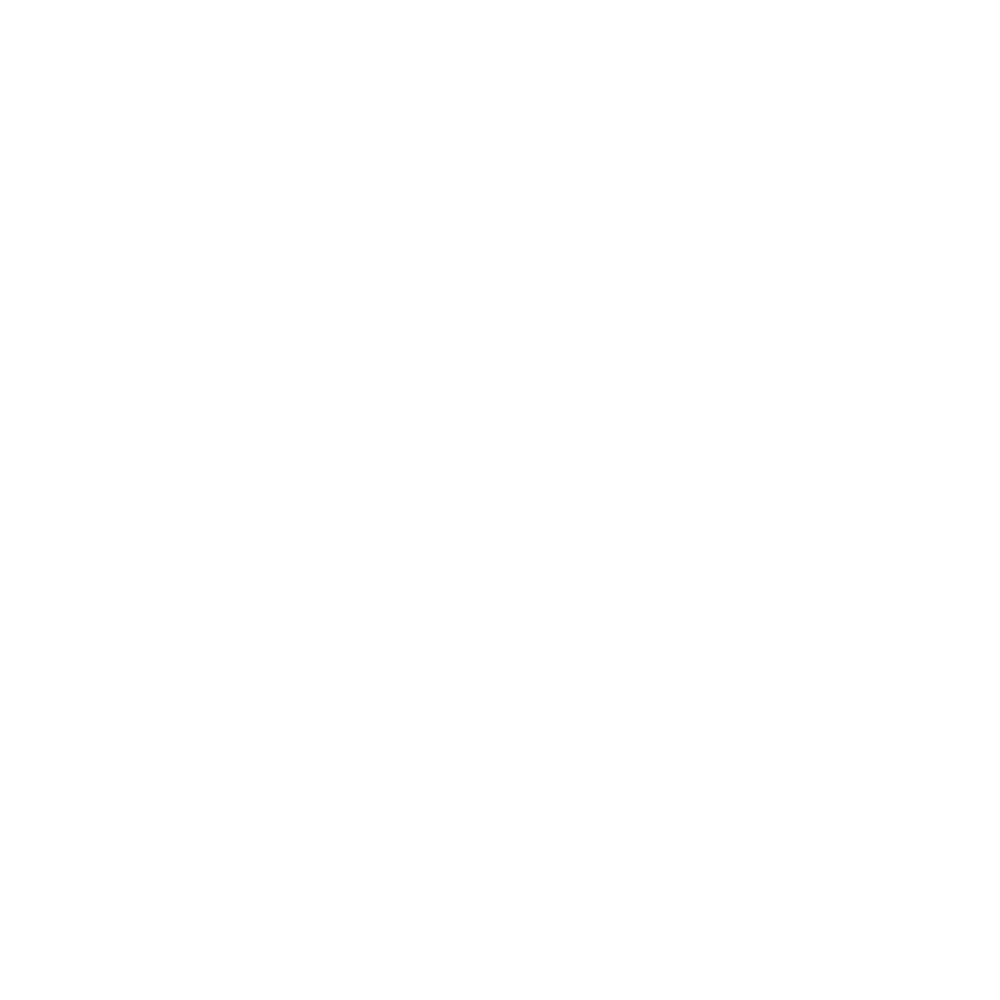

In [31]:
show_G(b_london_G)

In [56]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(35,900))

zwickau_inner_similarities_df = pd.DataFrame(zwickau_similarities)
london_inner_similarities_df = pd.DataFrame(london_similarities)
breslau_inner_similarities_df = pd.DataFrame(breslau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_inner_similarities_df.index):
        y_1 = zwickau_inner_similarities_df.iloc[i, :]
        ax.plot(y_1, label='a_zwickau')
    
    if i in list(london_inner_similarities_df.index):
        y_2 = london_inner_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    if i in list(breslau_inner_similarities_df.index):
        y_2 = breslau_inner_similarities_df.iloc[i, :]
        ax.plot(y_2, label='breslau')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [57]:
# plt.figure(figsize = (35,15))
# sns.heatmap(zwickau_inner_similarities_df, cmap="Greens") # font size

# plt.show()

In [58]:
# plt.figure(figsize = (35,15))
# sns.heatmap(london_inner_similarities_df, cmap="Greens") # font size

# plt.show()

In [62]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(35,900))

zwickau_breslau_similarities_df = pd.DataFrame(zwickau_breslau_similarities)
breslau_zwickau_similarities_df = pd.DataFrame(breslau_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_breslau_similarities_df.index):
        y_1 = zwickau_breslau_similarities_df.iloc[i,:]
        ax.plot(y_1, label='zwickau_to_breslau')
    
    if i in list(breslau_zwickau_similarities_df.index):
        y_2 = breslau_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_2, label='breslau_to_zwickau')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [63]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(35,900))

london_breslau_similarities_df = pd.DataFrame(london_breslau_similarities)
breslau_london_similarities_df = pd.DataFrame(breslau_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(london_breslau_similarities_df.index):
        y_1 = london_breslau_similarities_df.iloc[i,:]
        ax.plot(y_1, label='london_to_breslau')
    
    if i in list(breslau_london_similarities_df.index):
        y_2 = breslau_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='breslau_to_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [59]:
# plt.figure(figsize = (35,15))
# sns.heatmap(zwickau_london_similarities_df, cmap="Greens") # font size

# plt.show()

In [60]:
# plt.figure(figsize = (35,15))
# sns.heatmap(london_zwickau_similarities_df, cmap="Greens") # font size

# plt.show()